# Deliverables:

- Submit two files that are labeled: <b><font color = 'red'>YourLastName_Assignment_4<b></font> that have the following formats:

 1. Your **HTML** that has your Source code and output
 2. Your **ipynb script** that has your Source code and output


# Objectives:

- Use SQL to execute different queries to retrieve data from Chicago Crime dataset and Police statins dataset
- Use Geospatial queries  to locate **police stations** and **gun** related crimes (with arrest or no arrest) in every district on **Choropleth** map
- Use Geospatial queries  to provide **descriptive stat** for every **district** on Choropleth map
- Use Geospatial queries  to locate the **Block** that is the furthest (Maximum Distance) from the police station that has gun related crime resulted in arrest


# Formatting Python Code:

When programming in Python, refer to Kenneth Reitz’ PEP 8: The Style Guide for Python Code: http://pep8.org/ (Links to an external site.)Links to an external site. There is the Google style guide for Python at https://google.github.io/styleguide/pyguide.html (Links to an external site.)Links to an external site. Comment often and in detail.



# Descriptions and Requirement Specifications

# Chicago Police Department

Chicago police department  __[CPD](https://home.chicagopolice.org/community/districts/11th-district-harrison/)__  issues and publishes on daily basis on its website crime alerts, and press releases for the different __[districts](https://home.chicagopolice.org/community/districts/)__ .

Packages you need to Connect **PostgreSQL** server to load and retrieve Crhicago Crime dataset from the database:
<font color = purple>
1. **psycopg2:** for PostgreSQL driver
2. **area:** to calculate the area inside of any GeoJSON geometry
3. **Folium:** for Choropleth maps </font>


Since we are using PostGIS in our work, please read and bookmark __[Chapter 4. Using PostGIS: Data Management and Queries](https://postgis.net/docs/manual-1.4/ch04.html)__ 


In [3]:
# Install a pip package in the current Jupyter kernel
import sys
#!{sys.executable} -m pip install psycopg2

# if you are on a Mac and the above fails, use code below
!{sys.executable} -m pip install psycopg2-binary

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 2.2/2.2 MB 670.6 kB/s eta 0:00:0000:0100:01


In [4]:
# Install a pip package in the current Jupyter kernel
#import sys
!{sys.executable} -m pip install area

  Preparing metadata (setup.py) ... done
  Created wheel for area: filename=area-1.1.1-py3-none-any.whl size=3608 sha256=eb27f3cd12a35133a273fb5fe2805f0ab14967000c1f3628198dd142cf879dd8
  Stored in directory: /Users/harperdodd/Library/Caches/pip/wheels/93/11/25/9101ea5a0f1b69310cc188e146bbec38275aaf816391437324
Successfully built area


In [5]:
# Install a pip package in the current Jupyter kernel
#import sys
!{sys.executable} -m pip install folium

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 102.3/102.3 kB 902.9 kB/s eta 0:00:00a 0:00:01


In [216]:
import folium
from folium import plugins
from folium.plugins import MarkerCluster
import psycopg2
import csv
import pandas as pd
import json
from area import area

from psycopg2.extensions import ISOLATION_LEVEL_AUTOCOMMIT 
from IPython.display import display

# set up notebook to display multiple output in one cell
# from IPython.core.interactiveshell import InteractiveShell
# InteractiveShell.ast_node_interactivity = "all"

In [217]:
folium.__version__

'0.14.0'

In [218]:
psycopg2.__version__

'2.9.6 (dt dec pq3 ext lo64)'

# IMPORTANT NOTES:

- In this assignment you will be connecting to DSCC PostgreSQL server that has the database and tables already created on the server. 
- You need to use your NetID and password for login and passward to connect PostgreSQL server hosted on DSCC
- For the psycopg2.connect statements listed below, you must provide your NetID and password in order to connect to PostgreSQL server hosted on DSCC

In [444]:
# Use this data set for your final submission of your Assignment 3
# Uncomment the following line after you unit test your code and ready to run and submit your assignment on this dataset 

db_connection = psycopg2.connect(host='129.105.248.26',dbname="chicago_crimes", user="jet249")

# =======================================================================================================

# Use the following dataset for unit testing purposes only. It takes roughly 5 minutes to complete.
# Comment the following line when you are done with your unit testing and ready to run your assignment on the complete dataset and submit your Assignment 

# db_connection = psycopg2.connect(host = '129.105.248.26',dbname = "chicago_crimes_ut", user = "jet249")
db_connection.set_session(autocommit = True)

cursor = db_connection.cursor()

In [ ]:
# Uncomment and run this code when your transactions get "stuck"
#db_connection.rollback()

### Chicago Crimes Dataset

The Crimes_2001_to_present.csv is downloaded from Chicago data portal and it has roughly 6.5 million records.

While working on this dataset, It is prudent to make a note of the following:
1. Geospatial  queries are very demanding for system resouces like CPU, Memory, and DISK
2. We are interested in the data set of the past 2 years, and when you execute Geospatial type queries, please be advised that these queries slow down your machine. 
3. There are two dataset that you will use in this assignment
    - **chicago_crimes_ut**  : Use this  mini dataset that has data for rougly a month for coding/debugging and unit testing
    - **chicago_crimes** : Use this dataset that has data for 2 years for your final submission



### Algorithm Performance

- **Sort algorithms** used by the database engines vary in performance between O($N log N$) and O($ N^{2} $) where $N$ is the size of the number

- **Search algorithms** used by the database engines vary in performance between O($log N$) and O($ N $) where $N$ is the size of the number




**DATA DICTIONARY (CRIMES)** (See https://www.kaggle.com/currie32/crimes-in-chicago)

**id** - Unique identifier for the record.

**caseno** - The Chicago Police Department RD Number (Records Division Number), which is unique to the incident.

**date_of_occurence** - Date when the incident occurred. this is sometimes a best estimate.

**block - The partially redacted address where the incident occurred, placing it on the same block as the actual address.

**iucr** - The Illinois Unifrom Crime Reporting code. This is directly linked to the Primary Type and Description. See the list of IUCR codes at https://data.cityofchicago.org/d/c7ck-438e.

**primary_type** - The primary description of the IUCR code.

**description** - The secondary description of the IUCR code, a subcategory of the primary description.

**location-description** - Description of the location where the incident occurred.

**arrest** - Indicates whether an arrest was made.

**domestic** - Indicates whether the incident was domestic-related as defined by the Illinois Domestic Violence Act.

**beat** - Indicates the beat where the incident occurred. A beat is the smallest police geographic area – each beat has a dedicated police beat car. Three to five beats make up a police sector, and three sectors make up a police district. The Chicago Police Department has 22 police districts. See the beats at https://data.cityofchicago.org/d/aerh-rz74.

**district** - Indicates the police district where the incident occurred. See the districts at https://data.cityofchicago.org/d/fthy-xz3r.

**ward** - The ward (City Council district) where the incident occurred. See the wards at https://data.cityofchicago.org/d/sp34-6z76.

**community_area** - Indicates the community area where the incident occurred. Chicago has 77 community areas. See the community areas at https://data.cityofchicago.org/d/cauq-8yn6.

**fbi_cd** - Indicates the crime classification as outlined in the FBI's National Incident-Based Reporting System (NIBRS). See the Chicago Police Department listing of these classifications at http://gis.chicagopolice.org/clearmap_crime_sums/crime_types.html.

**xcoordinate** - The x coordinate of the location where the incident occurred in State Plane Illinois East NAD 1983 projection. This location is shifted from the actual location for partial redaction but falls on the same block.

**ycoordinate** - The y coordinate of the location where the incident occurred in State Plane Illinois East NAD 1983 projection. This location is shifted from the actual location for partial redaction but falls on the same block.

**year** - Year the incident occurred.

**updated_on** - Date and time the record was last updated.

**latitude** - The latitude of the location where the incident occurred. This location is shifted from the actual location for partial redaction but falls on the same block.

**longitude** - The longitude of the location where the incident occurred. This location is shifted from the actual location for partial redaction but falls on the same block.

**location** - The location where the incident occurred in a format that allows for creation of maps and other geographic operations on this data portal. This location is shifted from the actual location for partial redaction but falls on the same block.

<div class="alert alert-warning">

# Requirements

** The HTML document your are submitting must have the source code and the output for the following  requirements **
</div>

### Requirement #1: (10 points)

- Use SQL to select all rows of data with the following fields from crimes - district, ward, arrest, primary_type and location_description. 
- Create a dataframe called **new_df** with the selected fields.
- Make sure you name the columns in the dataframe.
- Show your **new_df** using info() and head().

In [445]:
query = "select district, ward, arrest, primary_type, location_description from crimes;"
new_df = pd.read_sql_query(query, db_connection)
new_df.columns = ['district', 'ward', 'arrest', 'primary_type', 'location_description']
new_df.info()
new_df.head()

/var/folders/jt/7kj6c3ln00lcx475vnbx1rjm0000gn/T/ipykernel_53397/2106636803.py:2: UserWarning: pandas only supports SQLAlchemy connectable (engine/connection) or database string URI or sqlite3 DBAPI2 connection. Other DBAPI2 objects are not tested. Please consider using SQLAlchemy.
  new_df = pd.read_sql_query(query, db_connection)


<class 'pandas.core.frame.DataFrame'>
RangeIndex: 587075 entries, 0 to 587074
Data columns (total 5 columns):
 #   Column                Non-Null Count   Dtype  
---  ------                --------------   -----  
 0   district              587075 non-null  int64  
 1   ward                  587075 non-null  float64
 2   arrest                587075 non-null  bool   
 3   primary_type          587075 non-null  object 
 4   location_description  587075 non-null  object 
dtypes: bool(1), float64(1), int64(1), object(2)
memory usage: 18.5+ MB


,district,ward,arrest,primary_type,location_description
0,16,36.0,False,BURGLARY,RESIDENCE-GARAGE
1,20,40.0,False,OTHER OFFENSE,APARTMENT
2,4,8.0,False,THEFT,APARTMENT
3,6,6.0,False,ASSAULT,RESTAURANT
4,7,17.0,False,THEFT,DEPARTMENT STORE


### Requirement #2: (10 points)

- Using **new_df**, show a crosstab of **primary_type** with the variable called **arrest**; Show the results as percentages.
- Use a Markdown cell to comment on what the results for the crime type of **Assault** tell us.


In [446]:
pd.crosstab(new_df['primary_type'], new_df['arrest']).apply(lambda x: (x/x.sum())*100).round(2)

arrest,False,True
primary_type,,
ARSON,0.20,0.08
ASSAULT,7.36,6.62
BATTERY,18.60,19.50
BURGLARY,6.01,1.13
CONCEALED CARRY LICENSE VIOLATION,0.00,0.10
CRIM SEXUAL ASSAULT,0.67,0.18
CRIMINAL DAMAGE,13.17,3.25
CRIMINAL TRESPASS,1.28,7.61
DECEPTIVE PRACTICE,7.65,1.46


This crosstab shows that Assaults make up roughly equal percentages of crimes that do have arrests and crimes that do not have an arrest. I believe that this particular statistic obfuscates a valuable insight.

In real terms, there are just over 42k assaults and the overall arrest rate for assaults is 18%. This follows the overall pattern of arrest rates for crimes being incredibly low, at about 20%. Which is to say that CPD is only able to perform its basic function about once every 5 crimes. The crosstab above hides the fact that most crimes do not lead to an arrest. If you were to remove narcotics crimes, which are nonviolent, from the overall table the result would be an even more damning reflection of CPD's capabilities since narcotics crimes make up about 24% of arrests overall.

Of course, it must be mentioned that an arrest does not necessarily mean that a crime is solved or that the correct person has been arrested. See outputs from the next block for metrics that relate to what i have written in this block.

In [447]:
query = "select arrest, count(*) as count from crimes\
         group by arrest;"
overall_arrest = pd.read_sql_query(query, db_connection)


query = "select arrest, count(*) as count from crimes\
         where primary_type = 'ASSAULT'\
         group by arrest;"
assault_arrest = pd.read_sql_query(query, db_connection)

query = "select count(*) as count from crimes \
         where primary_type = 'NARCOTICS';"

drug_arrests = pd.read_sql_query(query, db_connection)
drug_arrests

print("overall arrests: \n", overall_arrest, "\n\n narcotics arrests: \n", drug_arrests,  "\n\n assault arrests: \n", assault_arrest)

/var/folders/jt/7kj6c3ln00lcx475vnbx1rjm0000gn/T/ipykernel_53397/141211310.py:3: UserWarning: pandas only supports SQLAlchemy connectable (engine/connection) or database string URI or sqlite3 DBAPI2 connection. Other DBAPI2 objects are not tested. Please consider using SQLAlchemy.
  overall_arrest = pd.read_sql_query(query, db_connection)
/var/folders/jt/7kj6c3ln00lcx475vnbx1rjm0000gn/T/ipykernel_53397/141211310.py:9: UserWarning: pandas only supports SQLAlchemy connectable (engine/connection) or database string URI or sqlite3 DBAPI2 connection. Other DBAPI2 objects are not tested. Please consider using SQLAlchemy.
  assault_arrest = pd.read_sql_query(query, db_connection)


overall arrests: 
    arrest   count
0   False  471355
1    True  115720 

 narcotics arrests: 
    count
0  27687 

 assault arrests: 
    arrest  count
0   False  34708
1    True   7658


/var/folders/jt/7kj6c3ln00lcx475vnbx1rjm0000gn/T/ipykernel_53397/141211310.py:14: UserWarning: pandas only supports SQLAlchemy connectable (engine/connection) or database string URI or sqlite3 DBAPI2 connection. Other DBAPI2 objects are not tested. Please consider using SQLAlchemy.
  drug_arrests = pd.read_sql_query(query, db_connection)


### Requirement #3:  (10 points)
- Calculate the gun crimes density in every district. (See **Query 4**.)

In [448]:
district = []
tarea=[]

with open('Boundaries.geojson') as f:
    data = json.load(f)
    a = data['features'] # a is a list of district data (dictionaries)
    for i in range(len(a)):
        obj = a[i]['geometry'] # list of coordinates defining the ith district boundary
        n = a[i]['properties'] # dictionary with district number and district label keyes for ith district
        district.append(n['dist_num']) # add district number to the district list
        tarea.append(area(obj)/10000) # add the the area (in hectares) to area list

af = pd.DataFrame({'dist_num': district,'district_area_inHectares':tarea})
af['dist_num'] = af['dist_num'].astype(str)
final_data= pd.merge(af, districts_gun_crimes_df, on='dist_num', how='inner')
final_data['crime_density'] = round(final_data['gun_crimes']/(final_data['district_area_inHectares']/100))
final_data


,dist_num,district_area_inHectares,gun_crimes,crime_density
0,17,2492.727155,7,0.0
1,20,1132.170216,5,0.0
2,19,2225.035732,11,0.0
3,25,2827.989237,43,2.0
4,14,1555.869965,12,1.0
5,7,1688.670732,67,4.0
6,3,1576.063931,57,4.0
7,4,7068.152865,50,1.0
8,6,2099.682124,63,3.0
9,22,3490.416073,24,1.0


<div class="alert alert-block alert-info"> For Requirements 4 and 5, consider following the steps illustrated in the Queries:

<ul>
  <li>Create the data frame with the appropriate marker data.</li>
  <li>Create the folium base map.</li>
  <li>Add the Choropleth layer.</li>
  <li>Iterate over the data frame you created to place the markers on the folium map.</li>
   <li>Show the final map.</li>
</ul>
</div>

### Requirement #4: (15 points)

- Using Query #2 as an example, create a Choropleth map for the **violent crimes** that **resulted in an arrest.**
- The pins should be placed at the police station for each district.
- The legend should reflect the total violent crime count per district.
- The popup should show the number of total violent crimes per hour interval for that district. If you choose to extract the hour from date_of_occurrence using SQL, check out https://www.postgresql.org/docs/current/functions-datetime.html.

<div>
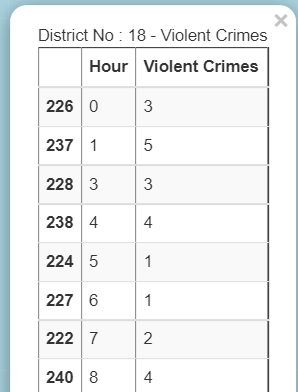
</div>

<b> Create the data frame with the appropriate marker data. <b>

In [449]:
violent_crime_categories = 'THEFT','ASSAULT','ROBBERY','KIDNAPPING','CRIM SEXUAL ASSAULT','BATTERY','MURDER'

cursor.execute(f"SELECT district, PRIMARY_TYPE, count(PRIMARY_TYPE) \
                    FROM crimes \
                    WHERE PRIMARY_TYPE in {violent_crime_categories} \
                    AND ARREST = 'True' \
                    GROUP BY distrIct,PRIMARY_TYPE")
rows = cursor.fetchall()
violent_crime_w_arrest = pd.DataFrame(rows, columns = ['dist_num', 'Description', 'violent_crimes_w_arrest'])
violent_crime_w_arrest['dist_num'] = violent_crime_w_arrest['dist_num'].astype(str)
violent_crime_w_arrest

,dist_num,Description,violent_crimes_w_arrest
0,1,ASSAULT,322
1,1,BATTERY,799
2,1,CRIM SEXUAL ASSAULT,8
3,1,ROBBERY,165
4,1,THEFT,2281
...,...,...,...
120,25,BATTERY,1285
121,25,CRIM SEXUAL ASSAULT,17
122,25,KIDNAPPING,2
123,25,ROBBERY,69


In [450]:
query4_df = pd.merge(violent_crime_w_arrest, station_locations, on = 'dist_num')
query4_df

,dist_num,Description,violent_crimes_w_arrest,st_latitude,st_longitude
0,1,ASSAULT,322,41.858373,-87.627356
1,1,BATTERY,799,41.858373,-87.627356
2,1,CRIM SEXUAL ASSAULT,8,41.858373,-87.627356
3,1,ROBBERY,165,41.858373,-87.627356
4,1,THEFT,2281,41.858373,-87.627356
...,...,...,...,...,...
120,25,BATTERY,1285,41.918609,-87.765574
121,25,CRIM SEXUAL ASSAULT,17,41.918609,-87.765574
122,25,KIDNAPPING,2,41.918609,-87.765574
123,25,ROBBERY,69,41.918609,-87.765574


<b>Create the folium base map and Choropleth layer.<b>

In [451]:
violent_crime_w_arrest_per_district_map = folium.Map(location = (41.8781, -87.6298), zoom_start = 11)
folium.Choropleth(geo_data = "Boundaries.geojson", 
              fill_color = 'YlOrRd', 
              fill_opacity = 0.5, 
              line_opacity = 1,
              data = violent_crime_w_arrest, #resulting df from violent crime with arrest query
              key_on = 'feature.properties.dist_num',
              columns = ['dist_num', 'violent_crimes_w_arrest'],
              legend_name = "VIOLENT CRIMES W ARREST PER DISTRICT"
              ).add_to(violent_crime_w_arrest_per_district_map)

<b>Iterate over the data frame you created to place the markers on the folium map.<b>

In [452]:
for district in districts:
    df4 = query4_df[query4_df.dist_num == district]  # new dataframe to add to marker.

    police_station_location = tuple(df4[['st_latitude', 'st_longitude']].values[0])

    violent_crimes_w_arrest_per_district_df = df4[['Description', 'violent_crimes_w_arrest']]
    # Convert out new data frame to html before inserting it into the label.
    header = violent_crimes_w_arrest_per_district_df.to_html(classes = 
                        'table table-striped table-hover table-condensed table-responsive')
    # Create the folium marker and add it to the map.
    folium.Marker(location = police_station_location, popup = folium.\
                  Popup(html = f"District Number {district} - Violent Crimes w Arrest {header}")).\
                  add_to(violent_crimes_w_arrest_per_district_map)

    # Create the marker and add it to the map.
    folium.Marker(location = police_station_location, 
    popup =\
    folium.Popup(html = f"District No : {district} - Violent Crimes w Arrest {header}", max_width = 450)).\
    add_to(violent_crimes_w_arrest_per_district_map)

<b>Show the final map.<b>

In [453]:
violent_crimes_w_arrest_per_district_map

### Requirement #5: (15 points) 

- Create **Marker Clusters** on Choropleth map for those **gun related crimes** that have Location Description as RESIDENCE in **(green icon)** and those that have Location Description as STREET in **(red icon)** (See **Query 5**.) 
- The legend should also reflect gun related crimes for STREET and RESIDENCE only.
- **Make sure to place the markers at the crime location.**

<b> Create the data frame with the appropriate marker data. <b>

In [454]:
gun='%GUN%'
cursor.execute(f"SELECT district, location_description, count(*) as count FROM crimes\
                 WHERE DESCRIPTION::text LIKE '{gun}'\
                 AND (location_description = 'STREET'\
                 OR location_description = 'RESIDENCE')\
                 GROUP BY district, location_description\
                 ORDER BY district;")
dist_gun_crime_by_location = cursor.fetchall()
dist_gun_crime_by_location_df = pd.DataFrame(dist_gun_crime_by_location,
                                             columns=['dist_num', 'location','count_gun_crimes'])
dist_gun_crime_by_location_df['dist_num'] = dist_gun_crime_by_location_df['dist_num'].astype(str)

# sum(dist_gun_crime_by_location_df['count_gun_crimes'])
#12577

dist_gun_crime_by_location_df

,dist_num,location,count_gun_crimes
0,1,RESIDENCE,6
1,1,STREET,125
2,2,RESIDENCE,30
3,2,STREET,506
4,3,RESIDENCE,71
5,3,STREET,625
6,4,RESIDENCE,176
7,4,STREET,667
8,5,RESIDENCE,258
9,5,STREET,750


In [455]:
data= []
for district in districts:
    cursor.execute(f"""SELECT  DISTINCT ON(caseno) caseno, block, DESCRIPTION, location_description, latitude, longitude\
                FROM crimes\
                WHERE district = {district} and DESCRIPTION::text LIKE '{gun}'\
                AND (location_description = 'STREET' OR location_description = 'RESIDENCE')
                """)
    results = cursor.fetchall()
    
    # insert the district number as the first element of each result list
    gun_crimes_per_dist = [[district]+list(result) for result in results]
    data += (gun_crimes_per_dist)

gun_crimes_per_dist_df = pd.DataFrame(data, columns=['dist_num','caseno','block',\
'Description','location_description', 'latitude', 'longitude'])
gun_crimes_per_dist_df['dist_num'] = gun_crimes_per_dist_df['dist_num'].astype(str)
# len(gun_crimes_per_dist_df)
#12577, which is same as block above
gun_crimes_per_dist_df

,dist_num,caseno,block,Description,location_description,latitude,longitude
0,1,HZ107438,0000X E RANDOLPH ST,ARMED: HANDGUN,STREET,41.884493,-87.626940
1,1,HZ110194,003XX S MICHIGAN AVE,ATTEMPT: ARMED-HANDGUN,STREET,41.877765,-87.624308
2,1,HZ111320,003XX E 21ST ST,ARMED: HANDGUN,STREET,41.854334,-87.620206
3,1,HZ113657,016XX S PRAIRIE AVE,ATTEMPT: ARMED-HANDGUN,STREET,41.859982,-87.620815
4,1,HZ113658,022XX S INDIANA AVE,ARMED: HANDGUN,STREET,41.852450,-87.622261
...,...,...,...,...,...,...,...
12572,25,JB202761,013XX N MASSASOIT AVE,AGGRAVATED: HANDGUN,STREET,41.904870,-87.769391
12573,25,JB204519,014XX N LINDER AVE,AGGRAVATED: HANDGUN,STREET,41.906774,-87.763335
12574,25,JB204642,017XX N KARLOV AVE,AGGRAVATED: HANDGUN,STREET,41.912147,-87.728848
12575,25,JB205292,014XX N MAYFIELD AVE,UNLAWFUL POSS OF HANDGUN,RESIDENCE,41.906112,-87.773072


<b>Create the folium base map and Choropleth layer.<b>

In [456]:
gun_crime_location_map = folium.Map(location =(41.8781, -87.6298),zoom_start=11)
folium.Choropleth(geo_data="Boundaries.geojson", 
              fill_color='YlOrRd', 
              fill_opacity=0.5, 
              line_opacity=1,
              data = districts_gun_crimes_df, #using data from Query 3
              key_on='feature.properties.dist_num',
              columns = ['dist_num', 'gun_crimes'],
              legend_name="GUN CRIME"
              ).add_to(gun_crime_location_map)
marker_cluster = MarkerCluster().add_to(gun_crime_location_map)

<b>Iterate over the data frame you created to place the markers on the folium map.<b>

In [457]:
gun='%GUN%'
for district in districts:
    gun_crimes_per_dist_df5 = gun_crimes_per_dist_df[gun_crimes_per_dist_df.dist_num==district]
    
    for index, row in gun_crimes_per_dist_df5.iterrows():
        description = row['Description']
        location_description = row['location_description']
        loc = (row['latitude'],row['longitude'])
#         print("District No: %s <br> Description: %s <br> Block: %s" %(district,description,block))
        if row['location_description'] =='STREET': 
            folium.Marker(location=loc,popup = folium.Popup(html=\
                f"District No: {district} <br> Description: {description} <br> Location: {location_description}"),\
                          icon=folium.Icon(color='green', icon='ok-sign'),).add_to(marker_cluster)
#             print(f"District {district} green marker at {loc}")
        else:
            folium.Marker(location=loc, popup = folium.Popup(html=
                 f"District No: {district} <br> Description: {description} <br> Location: {location_description}"),\
                          icon=folium.Icon(color='red',icon='remove-sign'),).add_to(marker_cluster)
 

<b>Show the final map.<b> 

In [458]:
gun_crime_location_map

### Requirement #6: (15 points)

- Create a seaborn scatterplot to show `THEFT`, `BATTERY`, `ASSAULT`, `ROBBERY` by the hour of the day. (Reference: https://seaborn.pydata.org/generated/seaborn.scatterplot.html)
- You can use SQL and/or Python to prepare the data for the plot.  If you choose to extract the hour from date_of_occurrence using SQL, check out https://www.postgresql.org/docs/current/functions-datetime.html.
- Number of crimes will be on the y-axis and hour of day will be on the x-axis. Be sure to provide a title and a legend for your plot.
- Using a markdown cell, explain the findings from the plot.


/var/folders/jt/7kj6c3ln00lcx475vnbx1rjm0000gn/T/ipykernel_53397/687567821.py:10: UserWarning: pandas only supports SQLAlchemy connectable (engine/connection) or database string URI or sqlite3 DBAPI2 connection. Other DBAPI2 objects are not tested. Please consider using SQLAlchemy.
  crime_by_time = pd.read_sql_query(query, db_connection)


[Text(0.5, 1.0, 'Crime by Time')]

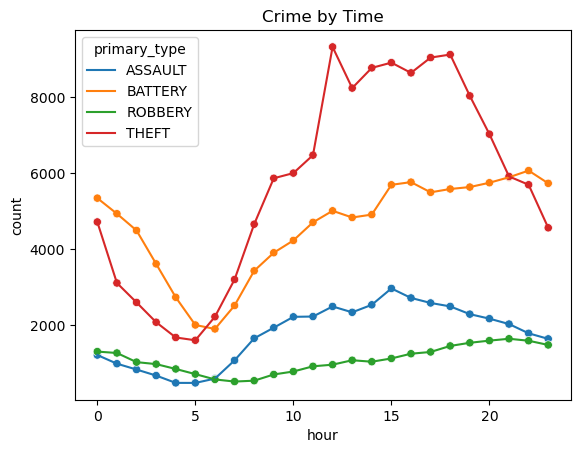

In [459]:
import seaborn as sns

query = "select extract(hour from date_of_occurrence) as hour, primary_type, count(*) as count from crimes \
         where primary_type = 'THEFT'\
         or primary_type = 'BATTERY'\
         or primary_type = 'ASSAULT'\
         or primary_type = 'ROBBERY'\
         group by hour, primary_type\
         order by hour asc;"
crime_by_time = pd.read_sql_query(query, db_connection)
crime_by_time_df = pd.DataFrame(crime_by_time)
crime_by_time_df

sns.lineplot(data = crime_by_time_df, x = "hour", y = "count", hue = "primary_type").set(title = 'Crime by Time')

sns.scatterplot(data = crime_by_time_df, x = "hour", y = "count",
                hue = "primary_type", legend = False).set(title = 'Crime by Time')

Overall, these crimes are at their lowest in the early morning hours (around 5am) and increase throughout the day with a drop off in the later evening. Battery and Theft see a local peak late at night, around midnight. This generally makes sense if you imagine batteries involving bar fights or similar alcohol related violence and thefts involving breaking into cars, etc on mostly empty streets. Theft is by far the most prevalent crime and also sees the highest increase from the morning to afternoon. This is somewhat reassuring as theft is not a crime that involves force or violence of any sort.